In [8]:
%load_ext autoreload
%autoreload 2
%env WANDB_SILENT=true

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
env: WANDB_SILENT=true


In [9]:
import torch
from torchmetrics.image import PeakSignalNoiseRatio, StructuralSimilarityIndexMeasure, LearnedPerceptualImagePatchSimilarity
import utils
from models import UNetMod, UNetModECA
from denoisers.dip import DIP, DDIP, SGDIP, PatchDIP, losses, schedules

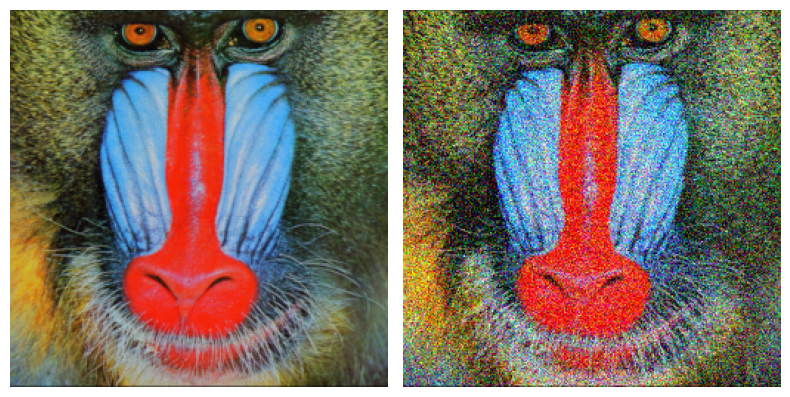

tensor(14.9999)


In [10]:
# clean = utils.load_celeba(30)
# clean = utils.load_images('./data/CBSD68/')
clean = utils.load_images('./data/Set14/')
# clean = utils.load_image("./data/set5/butterfly.png")
noisy = torch.stack([utils.get_noisy_image(img, 15) for img in clean])

utils.plot_row([clean[0], noisy[0]])

psnr = PeakSignalNoiseRatio(data_range=2)
print(psnr(noisy, clean))

In [11]:
# networks
net = UNetMod(hidden_ch=8, n_layers=4)
net1 = UNetModECA(hidden_ch=8, n_layers=4)

# schedules
linear = schedules.Linear(1, 10)
cos = schedules.Cos(0.1)

# losses
mse = losses.MSE()
nmse = losses.NMSE()

mse_ae = losses.Composed(losses.MSE(), losses.AE())
nmse_ae = losses.Composed(losses.NMSE(), losses.AE())

mse_tv = losses.Composed(losses.MSE(), losses.TV(), alpha=0.1)
nmse_tv = losses.Composed(losses.NMSE(), losses.TV(), alpha=0.1)

# variants
dip = DIP(net, losses.MSE())
dip_es = DIP(net, losses.MSE(), early_stopping=True)
dip_neighbor = DIP(net, losses.NMSE())
dip_neighbor_es = DIP(net, losses.NMSE(), early_stopping=True)
dip_tv = DIP(net, mse_tv)
dip_tv_es = DIP(net, mse_tv, early_stopping=True)

sgdip = SGDIP(net, mse_ae)
sgdip_es = SGDIP(net, mse_ae, early_stopping=True)
sgdip_neighbor = SGDIP(net, nmse_ae)
sgdip_neighbor_es = SGDIP(net, nmse_ae, early_stopping=True)

ddip = DDIP(net, losses.MSE(), cos)
ddip_neighbor = DDIP(net, losses.NMSE(), cos)

patch_dip = PatchDIP(net, losses.MSE(), threshold=0.2)

In [12]:
denoisers = [
    # sgdip_neighbor_es,
    # sgdip_es,
    # SGDIP(net, mse_ae.with_alpha(linear)),
    # SGDIP(net, nmse_ae.with_alpha(linear)),
    # dip_es,
    # dip_tv,
    # ddip,
    # ddip_neighbor,
    # patch_dip
    DIP(net1, mse, early_stopping=True),
    SGDIP(net1, mse_ae, early_stopping=True),
    SGDIP(net1, mse_ae.with_alpha(linear)),
    DIP(net, mse, early_stopping=True),
    SGDIP(net, mse_ae, early_stopping=True),
    SGDIP(net, mse_ae.with_alpha(linear)),
]

metrics = {
    "psnr": PeakSignalNoiseRatio(data_range=2),
    "ssim": StructuralSimilarityIndexMeasure(data_range=2),
}

results = {}
for i, denoiser in enumerate(denoisers):
    outputs = []
    for j, (y, x) in enumerate(zip(noisy, clean)):
        options = {
            "mode": "wandb",
            "config": {
                "project": "zero-shot-das-denoising",
                "entity": "jmaen-team",
                "group": "eca",
                "dataset": "set14-15",
                "denoiser_id": i,
                "data_id": j,
            },
            "metrics": metrics,
            "log_output": False,
        }
        output = denoiser.denoise(y.unsqueeze(0), x.unsqueeze(0), options)
        output = output.detach().clone().cpu()
        outputs.append(output)

    results[f"{i} - {denoiser.name()}"] = torch.cat(outputs)

Running: 0 - DIP - ES - MSE - UNetMod ECA 


 48%|████▊     | 969/2000 [00:43<00:46, 22.17it/s]


Running: 1 - DIP - ES - MSE - UNetMod ECA 


 45%|████▍     | 898/2000 [00:38<00:47, 23.26it/s]


Running: 2 - DIP - ES - MSE - UNetMod ECA 


 50%|█████     | 1004/2000 [00:49<00:49, 20.13it/s]


Running: 3 - DIP - ES - MSE - UNetMod ECA 


 48%|████▊     | 967/2000 [00:41<00:44, 23.27it/s]


Running: 4 - DIP - ES - MSE - UNetMod ECA 


 63%|██████▎   | 1256/2000 [00:47<00:28, 26.38it/s]


Running: 5 - DIP - ES - MSE - UNetMod ECA 


 44%|████▍     | 884/2000 [00:33<00:42, 26.04it/s]


Running: 6 - DIP - ES - MSE - UNetMod ECA 


 47%|████▋     | 934/2000 [00:35<00:40, 26.60it/s]


Running: 7 - DIP - ES - MSE - UNetMod ECA 


 44%|████▍     | 880/2000 [00:39<00:50, 22.36it/s]


Running: 8 - DIP - ES - MSE - UNetMod ECA 


 49%|████▉     | 976/2000 [00:37<00:39, 26.18it/s]


Running: 9 - DIP - ES - MSE - UNetMod ECA 


 47%|████▋     | 943/2000 [00:38<00:42, 24.79it/s]


Running: 10 - DIP - ES - MSE - UNetMod ECA 


 46%|████▌     | 923/2000 [00:39<00:45, 23.58it/s]


Running: 11 - DIP - ES - MSE - UNetMod ECA 


 45%|████▌     | 906/2000 [00:34<00:41, 26.30it/s]


Running: 12 - DIP - ES - MSE - UNetMod ECA 


 64%|██████▍   | 1281/2000 [00:49<00:28, 25.63it/s]


Running: 13 - DIP - ES - MSE - UNetMod ECA 


 43%|████▎     | 858/2000 [00:31<00:42, 26.93it/s]


Running: 0 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 79%|███████▉  | 1589/2000 [02:40<00:41,  9.89it/s]


Running: 1 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 74%|███████▎  | 1472/2000 [02:24<00:51, 10.16it/s]


Running: 2 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 74%|███████▍  | 1485/2000 [02:28<00:51,  9.99it/s]


Running: 3 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 87%|████████▋ | 1749/2000 [02:53<00:24, 10.10it/s]


Running: 4 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 51%|█████     | 1011/2000 [01:40<01:38, 10.02it/s]


Running: 5 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 90%|█████████ | 1802/2000 [02:56<00:19, 10.19it/s]


Running: 6 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 54%|█████▍    | 1079/2000 [01:47<01:31, 10.05it/s]


Running: 7 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 82%|████████▏ | 1642/2000 [02:44<00:35, 10.00it/s]


Running: 8 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 97%|█████████▋| 1933/2000 [03:15<00:06,  9.90it/s]


Running: 9 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 80%|███████▉  | 1590/2000 [02:59<00:46,  8.86it/s]


Running: 10 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 57%|█████▋    | 1134/2000 [02:13<01:42,  8.48it/s]


Running: 11 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 80%|███████▉  | 1598/2000 [02:58<00:44,  8.97it/s]


Running: 12 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 60%|█████▉    | 1197/2000 [02:16<01:31,  8.77it/s]


Running: 13 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 52%|█████▏    | 1042/2000 [01:52<01:43,  9.24it/s]


Running: 0 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:46<00:00,  8.82it/s]


Running: 1 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:53<00:00,  8.55it/s]


Running: 2 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:16<00:00, 10.16it/s]


Running: 3 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:55<00:00,  8.50it/s]


Running: 4 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:13<00:00, 10.36it/s]


Running: 5 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:23<00:00,  9.82it/s]


Running: 6 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:33<00:00,  9.35it/s]


Running: 7 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:34<00:00,  9.34it/s]


Running: 8 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:29<00:00,  9.55it/s]


Running: 9 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:32<00:00,  9.42it/s]


Running: 10 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:22<00:00,  9.89it/s]


Running: 11 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:27<00:00,  9.63it/s]


Running: 12 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:20<00:00,  9.98it/s]


Running: 13 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:17<00:00, 10.13it/s]


Running: 0 - DIP - ES - MSE - UNetMod 


 47%|████▋     | 939/2000 [00:34<00:38, 27.60it/s]


Running: 1 - DIP - ES - MSE - UNetMod 


 44%|████▍     | 881/2000 [00:33<00:42, 26.12it/s]


Running: 2 - DIP - ES - MSE - UNetMod 


 47%|████▋     | 939/2000 [00:35<00:40, 26.34it/s]


Running: 3 - DIP - ES - MSE - UNetMod 


 51%|█████     | 1023/2000 [00:37<00:35, 27.35it/s]


Running: 4 - DIP - ES - MSE - UNetMod 


 52%|█████▏    | 1037/2000 [00:39<00:36, 26.38it/s]


Running: 5 - DIP - ES - MSE - UNetMod 


 46%|████▌     | 910/2000 [00:35<00:42, 25.57it/s]


Running: 6 - DIP - ES - MSE - UNetMod 


 45%|████▌     | 905/2000 [00:35<00:42, 25.50it/s]


Running: 7 - DIP - ES - MSE - UNetMod 


 45%|████▍     | 895/2000 [00:34<00:42, 25.96it/s]


Running: 8 - DIP - ES - MSE - UNetMod 


 40%|███▉      | 792/2000 [00:31<00:48, 24.91it/s]


Running: 9 - DIP - ES - MSE - UNetMod 


 45%|████▌     | 903/2000 [00:34<00:41, 26.52it/s]


Running: 10 - DIP - ES - MSE - UNetMod 


 48%|████▊     | 969/2000 [00:44<00:47, 21.86it/s]


Running: 11 - DIP - ES - MSE - UNetMod 


 53%|█████▎    | 1069/2000 [00:45<00:39, 23.73it/s]


Running: 12 - DIP - ES - MSE - UNetMod 


 48%|████▊     | 969/2000 [00:39<00:41, 24.81it/s]


Running: 13 - DIP - ES - MSE - UNetMod 


 48%|████▊     | 950/2000 [00:42<00:46, 22.57it/s]


Running: 0 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 56%|█████▋    | 1128/2000 [01:47<01:23, 10.48it/s]


Running: 1 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 75%|███████▌  | 1504/2000 [02:23<00:47, 10.50it/s]


Running: 2 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 57%|█████▋    | 1135/2000 [01:49<01:23, 10.37it/s]


Running: 3 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 71%|███████   | 1421/2000 [02:19<00:56, 10.20it/s]


Running: 4 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 48%|████▊     | 964/2000 [01:32<01:39, 10.41it/s]


Running: 5 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 67%|██████▋   | 1343/2000 [02:06<01:02, 10.59it/s]


Running: 6 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 51%|█████     | 1022/2000 [01:36<01:32, 10.57it/s]


Running: 7 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 90%|████████▉ | 1791/2000 [02:49<00:19, 10.59it/s]


Running: 8 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 86%|████████▌ | 1721/2000 [02:40<00:26, 10.69it/s]


Running: 9 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 53%|█████▎    | 1051/2000 [01:37<01:28, 10.73it/s]


Running: 10 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 51%|█████▏    | 1027/2000 [01:37<01:32, 10.52it/s]


Running: 11 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 71%|███████   | 1418/2000 [02:12<00:54, 10.67it/s]


Running: 12 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 55%|█████▌    | 1108/2000 [01:45<01:24, 10.55it/s]


Running: 13 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 52%|█████▏    | 1043/2000 [01:38<01:30, 10.62it/s]


Running: 0 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:24<00:00,  9.79it/s]


Running: 1 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:14<00:00, 10.26it/s]


Running: 2 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:29<00:00,  9.56it/s]


Running: 3 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:40<00:00,  9.08it/s]


Running: 4 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:30<00:00,  9.48it/s]


Running: 5 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:43<00:00,  8.93it/s]


Running: 6 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:21<00:00,  9.90it/s]


Running: 7 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:19<00:00, 10.04it/s]


Running: 8 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:26<00:00,  9.71it/s]


Running: 9 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:27<00:00,  9.62it/s]


Running: 10 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:22<00:00,  9.86it/s]


Running: 11 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:19<00:00, 10.01it/s]


Running: 12 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:20<00:00,  9.99it/s]


Running: 13 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:20<00:00,  9.98it/s]


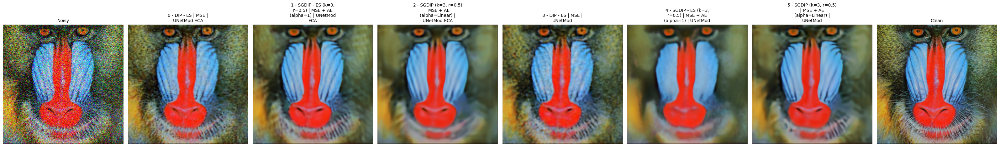

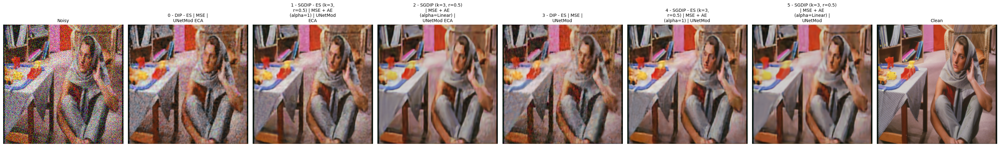

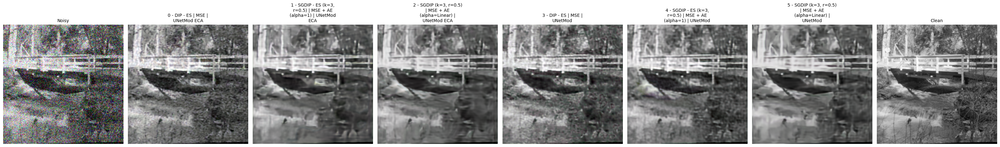

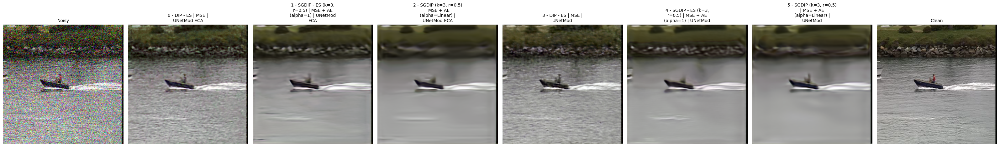

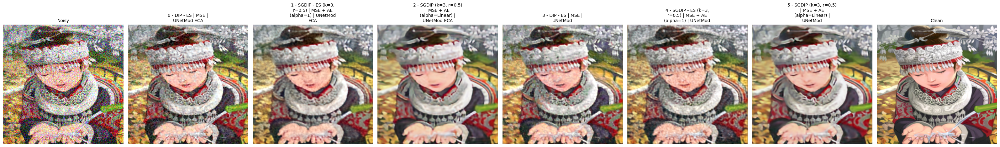

...

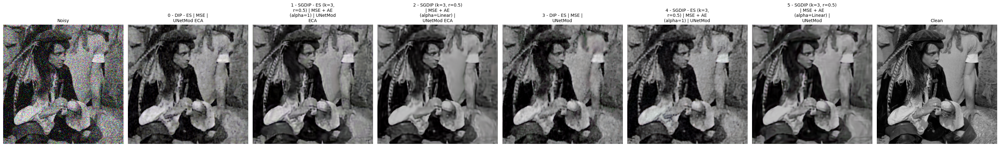

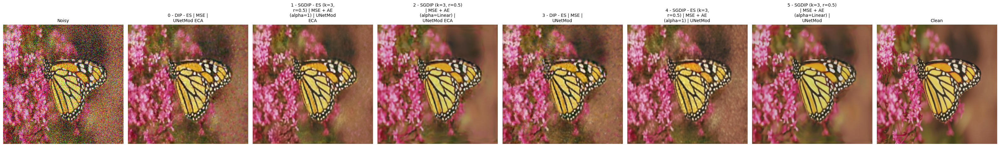

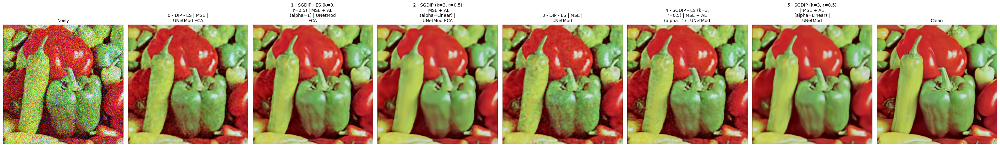

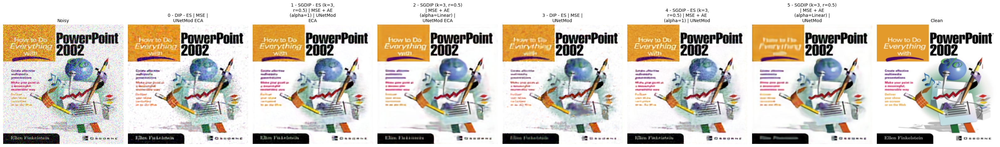

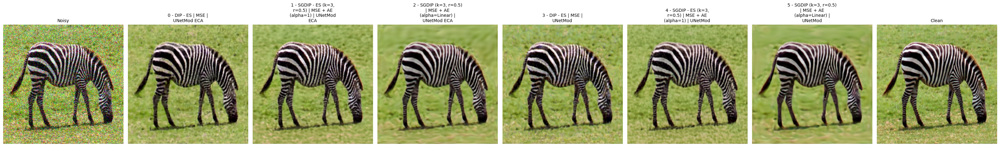

In [13]:
for result in zip(noisy, *results.values(), clean):
    utils.plot_row(result, ["Noisy", *list(results.keys()), "Clean"])

In [14]:
metrics = {
    "PSNR": PeakSignalNoiseRatio(data_range=2, reduction=None, dim=[1, 2, 3]),
    "SSIM": StructuralSimilarityIndexMeasure(data_range=2, reduction=None),
    # "LPIPS": LearnedPerceptualImagePatchSimilarity(),
}

for key, metric in metrics.items():
	print(key)
	print("----------")
	print(f"Noisy:".ljust(60), f"{metric(noisy, clean).mean()}")
	for name, xs in results.items():
		s = metric(xs, clean)
		print(f"{name}:".ljust(60), f"{s.mean()} ({s.var()})\t{s.tolist()}")
	print("\n")

PSNR
----------
Noisy:                                                       14.999958992004395
0 - DIP - ES | MSE | UNetMod ECA :                           24.95792007446289 (2.347015619277954)	[23.317163467407227, 24.644786834716797, 24.8350887298584, 25.760372161865234, 22.411033630371094, 27.431293487548828, 23.906085968017578, 27.455507278442383, 26.232582092285156, 25.349184036254883, 24.777267456054688, 26.14263153076172, 23.388668060302734, 23.759183883666992]
1 - SGDIP - ES (k=3, r=0.5) | MSE + AE (alpha=1) | UNetMod ECA : 26.1148681640625 (4.420083999633789)	[23.45241355895996, 25.90492057800293, 25.39723777770996, 26.272798538208008, 22.7322998046875, 29.17803955078125, 23.96393394470215, 29.847742080688477, 28.33824348449707, 26.546415328979492, 26.022823333740234, 27.839431762695312, 25.210599899291992, 24.901264190673828]
2 - SGDIP (k=3, r=0.5) | MSE + AE (alpha=Linear) | UNetMod ECA : 26.401147842407227 (4.167272567749023)	[23.100444793701172, 26.133934020996094, 25.6815